In [1]:
import matplotlib
import matplotlib.pyplot as plt 
import numpy as np
import pandas as pd
import os
import umap
import datashader as ds
import colorcet as cc
import igraph
import tqdm
from sklearn.neighbors import NearestNeighbors

from dredFISH.Analysis import TissueGraph
from dredFISH.Visualization import Viz
from dredFISH.Utils.__init__plots import * 
from dredFISH.Utils import powerplots
import importlib
importlib.reload(Viz)
importlib.reload(TissueGraph)

<module 'dredFISH.Analysis.TissueGraph' from '/bigstore/GeneralStorage/fangming/projects/dredfish/packages/dredFISH/dredFISH/Analysis/TissueGraph.py'>

#### Load data

In [2]:
respath = '/bigstore/GeneralStorage/fangming/projects/dredfish/figures/'

In [3]:
basepth = '/bigstore/GeneralStorage/Data/dredFISH/Dataset1'
!ls -alhtr $basepth
!head $basepth"/TMG.json"

total 81M
-rw-r--r-- 1 zach     wollmanlab  16M Jun  9 14:55 DPNMF_PolyA_2021Nov19_Section_-1850X_270Y_matrix.csv
-rw-r--r-- 1 zach     wollmanlab  20M Jun  9 14:55 DPNMF_PolyA_2021Nov19_Section_-1850X_270Y_metadata.csv
drwxrwxr-x 2 rwollman wollmanlab 4.0K Jul  7 12:18 .
-rw-rw-r-- 1 rwollman wollmanlab  165 Jul  7 16:00 TMG.json
-rw-r--r-- 1 fangming wollmanlab  40M Jul  7 16:00 cell.h5ad
-rw-r--r-- 1 fangming wollmanlab 6.8M Jul  7 16:00 isozone.h5ad
-rw-rw-r-- 1 rwollman wollmanlab 647K Jul  7 16:00 region.h5ad
-rw-r--r-- 1 fangming wollmanlab    3 Jul  7 16:00 Taxonomy_clusters.csv
-rw-r--r-- 1 fangming wollmanlab    3 Jul  7 16:00 Taxonomy_topics.csv
drwxrwxrwx 7 zach     wollmanlab 4.0K Jul  8 12:44 ..
{"layers_graph": [[0, 1], [0, 2]], "layer_taxonomy_mapping": {"0": 0, "1": 0, "2": 1}, "Taxonomies": ["clusters", "topics"], "Layers": ["cell", "isozone", "region"]}

In [4]:
TMG = TissueGraph.TissueMultiGraph(basepath=basepth, 
                                   redo=False, # load existing 
                                  )
TMG

/bigstore/GeneralStorage/Data/dredFISH/Dataset1/cell.h5ad
/bigstore/GeneralStorage/Data/dredFISH/Dataset1/isozone.h5ad
/bigstore/GeneralStorage/Data/dredFISH/Dataset1/region.h5ad


In [5]:
# spatial coordinates
layer = TMG.Layers[0]
XY = layer.XY
x, y = XY[:,0], XY[:,1]
###
x, y = y, x # a temporary hack
###

N = layer.N
print(N)
# measured basis
ftrs_mat = TMG.Layers[0].feature_mat

umap_mat = umap.UMAP(n_neighbors=30, min_dist=0.1).fit_transform(ftrs_mat)

# types

# regions

77846


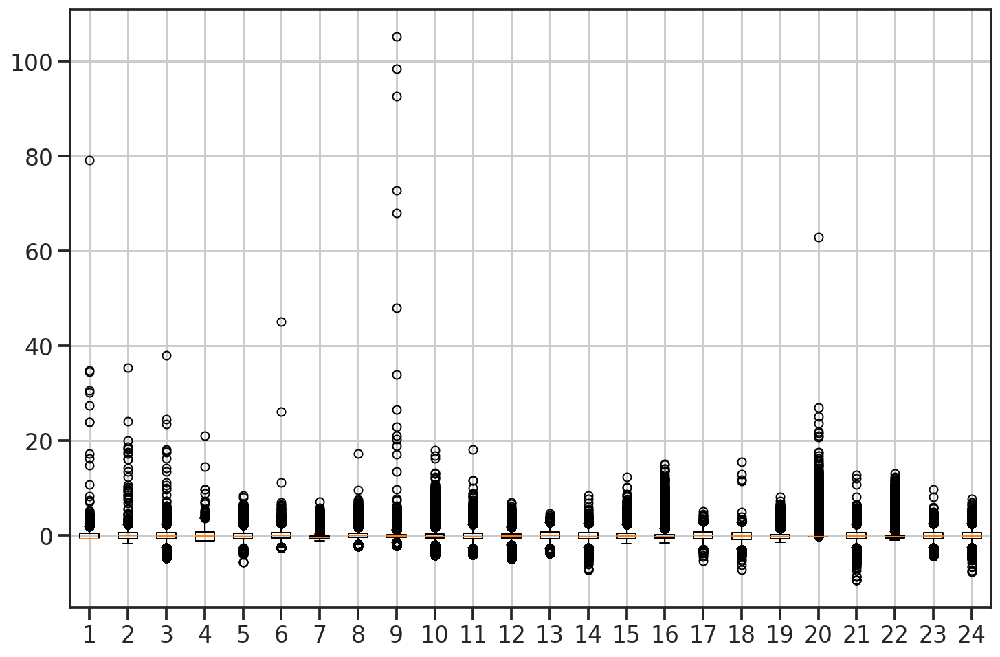

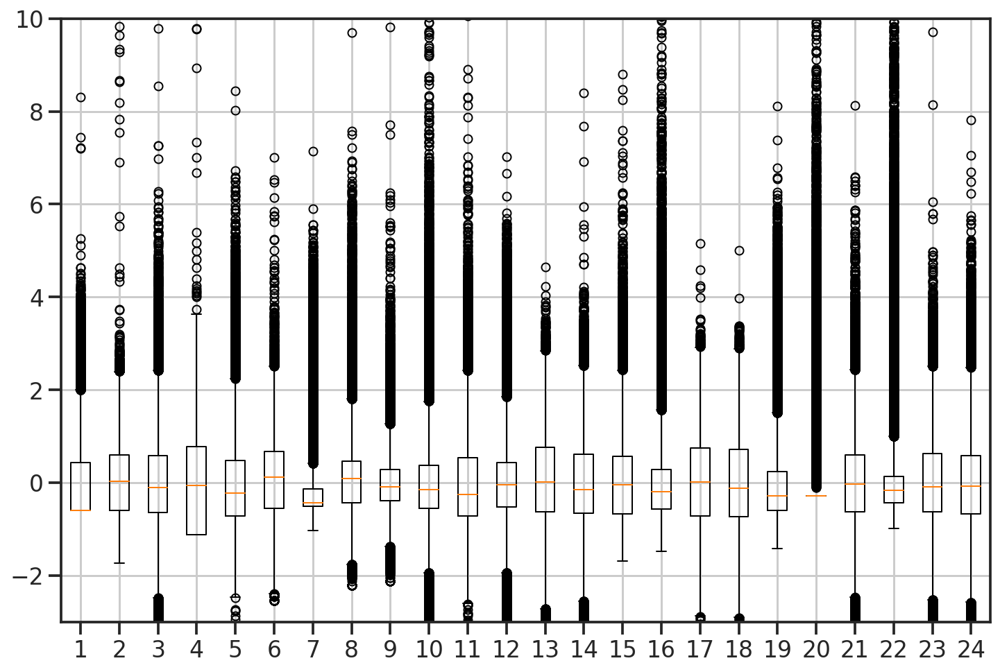

In [6]:
fig, ax = plt.subplots(figsize=(12,8))
ax.boxplot(ftrs_mat)
# ax.set_ylim([-3,10])
plt.show()

fig, ax = plt.subplots(figsize=(12,8))
ax.boxplot(ftrs_mat)
ax.set_ylim([-3,10])
plt.show()

In [7]:
df = pd.DataFrame()
df['x'] = x
df['y'] = y
df['umap_x'] = umap_mat[:,0]
df['umap_y'] = umap_mat[:,1]
for i in range(24):
    df[f'b{i}'] = ftrs_mat[:,i]
df

,x,y,umap_x,umap_y,b0,b1,b2,b3,b4,b5,...,b14,b15,b16,b17,b18,b19,b20,b21,b22,b23
0,1911.666962,-1749.638192,-1.901928,-2.967294,-0.603849,1.714861,0.594060,0.139496,1.509942,-0.114950,...,-1.042621,-0.377495,-1.338384,-1.124956,-0.155036,-0.286638,-0.387834,-0.117224,-0.410755,1.181027
1,1850.678429,-1747.172043,-1.789862,-2.849200,-0.530279,1.681959,1.301185,-0.464006,1.570054,-0.461933,...,-1.203702,-0.556397,-1.356768,-0.828398,-0.328228,-0.286638,-0.932215,-0.271226,-0.222204,1.127544
2,1515.123295,-1746.940031,0.184749,0.178933,-0.603849,-0.362498,0.620053,-1.128423,1.206578,-2.549739,...,-0.648550,-0.232972,-1.052768,0.648169,-0.999444,-0.286638,-0.556354,-0.144253,0.490684,2.188804
3,1426.161788,-1748.456394,-0.917661,0.854812,-0.298989,1.023065,1.517082,-0.341796,0.475449,0.173852,...,-0.788941,-0.282583,-0.611566,-0.450966,0.128447,-0.286638,-0.721338,0.160502,-0.223867,0.029698
4,1739.792930,-1749.407386,2.384448,-0.265512,-0.603849,-1.351786,1.025515,-1.128423,0.327118,-1.435450,...,-0.761760,-0.927360,-1.564878,-0.801772,1.826586,-0.286638,-1.689133,0.265159,-1.215811,1.532146
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
77841,-2188.756848,-1084.480934,-4.423579,4.242474,-0.603849,-0.271399,-0.666686,0.269214,0.821624,-0.652041,...,0.200085,0.508830,-0.120465,0.859582,-0.367392,-0.286638,1.523995,-0.829305,0.446156,-0.338945
77842,-2257.822983,-1083.270665,-5.205501,5.288445,0.936062,0.386319,-0.614982,1.752306,0.067531,0.282673,...,0.525392,-0.027365,-0.013067,0.760336,-0.100553,-0.286638,-0.447374,0.035593,-0.106235,-0.503376
77843,-2475.320577,-1083.995803,-5.016026,4.596395,-0.603849,-0.228163,-0.612215,0.895132,0.247026,-0.901201,...,0.134591,-0.110296,0.118158,1.764126,-0.434788,1.756892,-0.534186,-0.061414,0.108948,-0.438144
77844,-2311.578984,-1086.717336,1.987716,0.121741,-0.603849,-1.153599,0.699586,-0.204732,1.546018,0.460290,...,0.183778,1.903259,-0.663014,0.873821,0.287583,-0.286638,-0.295560,-0.354058,0.229195,-1.402028


464 375
saved the figure to: /bigstore/GeneralStorage/fangming/projects/dredfish/figures/basis_space_2022-07-14.pdf


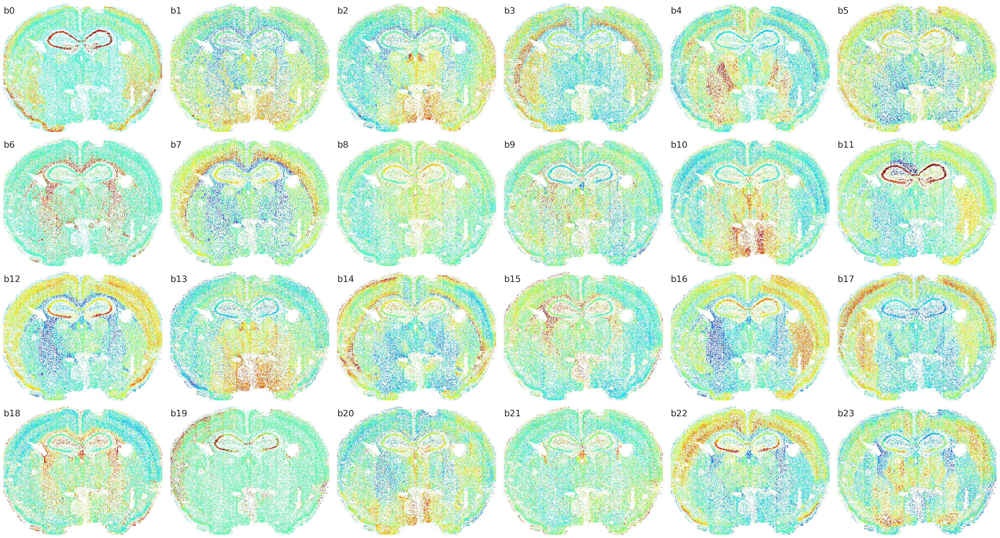

CPU times: user 19.1 s, sys: 340 ms, total: 19.5 s
Wall time: 19.6 s


In [8]:
%%time
path = os.path.join(respath, 'basis_space.pdf')
P = powerplots.PlotScale(df['x'].max()-df['x'].min(), 
                         df['y'].max()-df['y'].min(),
                         # npxlx=300,
                         pxl_scale=20,
                        )
print(P.npxlx, P.npxly)

nx, ny = 6, 4
fig, axs = plt.subplots(ny, nx, figsize=(nx*6, ny*5))
for i in range(24):
    ax = axs.flat[i]
    aggdata = ds.Canvas(P.npxlx, P.npxly).points(df, 'x', 'y', agg=ds.mean(f'b{i}'))
    ax.imshow(aggdata, origin='lower', aspect='equal', cmap='jet', vmin=-3, vmax=3, interpolation='none')
    ax.set_title(f'b{i}', loc='left', y=0.9)
    ax.axis('off')
fig.subplots_adjust(wspace=0.05, hspace=0)
powerplots.savefig_autodate(fig, path)
plt.show()

300 320
saved the figure to: /bigstore/GeneralStorage/fangming/projects/dredfish/figures/basis_umap_2022-07-14.pdf


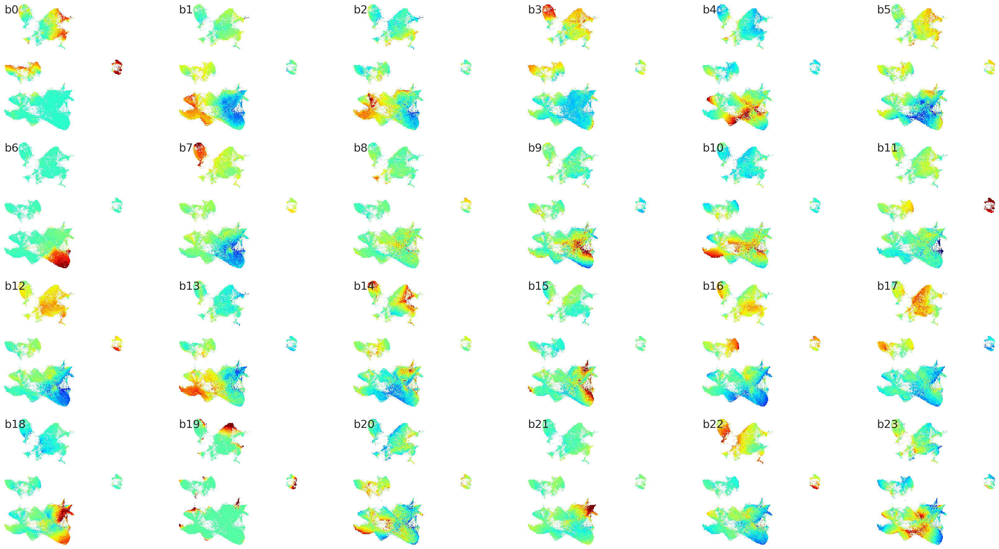

CPU times: user 14.9 s, sys: 292 ms, total: 15.2 s
Wall time: 15.3 s


In [9]:
%%time
x, y = 'umap_x', 'umap_y'
path = os.path.join(respath, 'basis_umap.pdf')
P = powerplots.PlotScale(df[x].max()-df[x].min(), 
                         df[y].max()-df[y].min(),
                         npxlx=300,
                        )
print(P.npxlx, P.npxly)

nx, ny = 6, 4
fig, axs = plt.subplots(ny, nx, figsize=(nx*5, ny*4))
for i in range(24):
    ax = axs.flat[i]
    aggdata = ds.Canvas(P.npxlx, P.npxly).points(df, x, y, agg=ds.mean(f'b{i}'))
    ax.imshow(aggdata, origin='lower', aspect='equal', cmap='jet', vmin=-3, vmax=3, interpolation='none')
    ax.set_title(f'b{i}', loc='left', y=0.9)
    ax.axis('off')
fig.subplots_adjust(wspace=0.05, hspace=0.1)
powerplots.savefig_autodate(fig, path)
plt.show()

# Cell types (Leiden clustering)

In [10]:
import leidenalg as la
def leiden(G, cells,
           resolution=1, seed=0, n_iteration=2,
           **kwargs,
          ):
    """cells are in order
    """
    partition = la.find_partition(G, 
                                  la.RBConfigurationVertexPartition, # modularity with resolution
                                  resolution_parameter=resolution, seed=seed, n_iterations=n_iteration, **kwargs)
    # get cluster labels from partition
    labels = [0]*(len(cells)) 
    for i, cluster in enumerate(partition):
        for element in cluster:
            labels[element] = i+1
    return labels



In [11]:
r = 1
layer = TMG.Layers[0]
G = layer.FG
cells = layer.adata.obs.index.values

In [12]:
%%time
resolutions = [0.01, 0.02, 0.05, 0.1, 0.2, 0.5, 1,2,5,10]
for r in tqdm.tqdm(resolutions):
    types = leiden(G, cells, resolution=r)
    df[f'type_r{r}'] = np.char.add('t', np.array(types).astype(str))

100%|██████████| 10/10 [00:42<00:00,  4.27s/it]

CPU times: user 42.7 s, sys: 312 ms, total: 43 s
Wall time: 42.7 s


In [13]:
df

,x,y,umap_x,umap_y,b0,b1,b2,b3,b4,b5,...,type_r0.01,type_r0.02,type_r0.05,type_r0.1,type_r0.2,type_r0.5,type_r1,type_r2,type_r5,type_r10
0,1911.666962,-1749.638192,-1.901928,-2.967294,-0.603849,1.714861,0.594060,0.139496,1.509942,-0.114950,...,t1,t1,t1,t3,t2,t5,t8,t14,t42,t35
1,1850.678429,-1747.172043,-1.789862,-2.849200,-0.530279,1.681959,1.301185,-0.464006,1.570054,-0.461933,...,t1,t1,t1,t3,t2,t5,t8,t14,t42,t35
2,1515.123295,-1746.940031,0.184749,0.178933,-0.603849,-0.362498,0.620053,-1.128423,1.206578,-2.549739,...,t1,t1,t1,t3,t2,t5,t10,t4,t34,t61
3,1426.161788,-1748.456394,-0.917661,0.854812,-0.298989,1.023065,1.517082,-0.341796,0.475449,0.173852,...,t1,t1,t1,t3,t2,t4,t10,t4,t53,t63
4,1739.792930,-1749.407386,2.384448,-0.265512,-0.603849,-1.351786,1.025515,-1.128423,0.327118,-1.435450,...,t1,t1,t1,t1,t1,t1,t6,t3,t19,t13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
77841,-2188.756848,-1084.480934,-4.423579,4.242474,-0.603849,-0.271399,-0.666686,0.269214,0.821624,-0.652041,...,t1,t1,t1,t3,t2,t8,t12,t24,t60,t60
77842,-2257.822983,-1083.270665,-5.205501,5.288445,0.936062,0.386319,-0.614982,1.752306,0.067531,0.282673,...,t1,t1,t3,t4,t6,t8,t12,t7,t3,t1
77843,-2475.320577,-1083.995803,-5.016026,4.596395,-0.603849,-0.228163,-0.612215,0.895132,0.247026,-0.901201,...,t1,t1,t2,t2,t5,t7,t7,t25,t48,t48
77844,-2311.578984,-1086.717336,1.987716,0.121741,-0.603849,-1.153599,0.699586,-0.204732,1.546018,0.460290,...,t1,t1,t1,t1,t1,t1,t6,t6,t50,t108


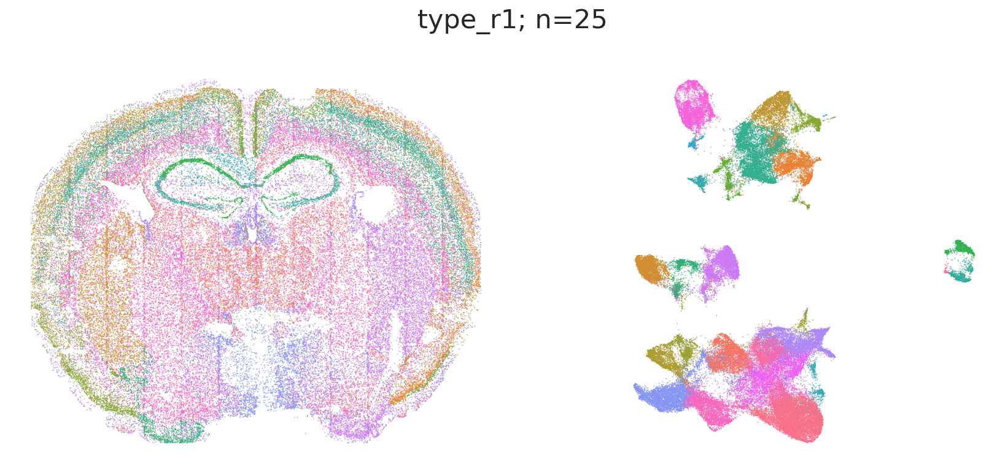

CPU times: user 2.57 s, sys: 7.97 ms, total: 2.58 s
Wall time: 2.57 s


In [14]:
%%time
hue = 'type_r1'
hue_order = np.sort(np.unique(df[hue]))
ntypes = len(hue_order)
        
fig, axs = plt.subplots(1, 2, figsize=(8*2,6))
fig.suptitle(f"{hue}; n={ntypes}")
ax = axs[0]
sns.scatterplot(data=df, x='x', y='y', 
                hue=hue, hue_order=hue_order, 
                s=0.5, edgecolor=None, 
                legend=False,
                ax=ax)
# ax.legend(loc='upper left', bbox_to_anchor=(0, -0.1), ncol=5)
ax.set_aspect('equal')
ax.axis('off')

ax = axs[1]
sns.scatterplot(data=df, x='umap_x', y='umap_y', 
                hue=hue, hue_order=hue_order, 
                s=0.5, edgecolor=None, 
                legend=False,
                ax=ax)
# ax.legend(loc='upper left', bbox_to_anchor=(0, -0.1), ncol=5)
ax.set_aspect('equal')
ax.axis('off')
fig.subplots_adjust(wspace=0)
plt.show()

In [15]:
np.unique(df['type_r0.02'], return_counts=True)

(array(['t1', 't2', 't3'], dtype=object), array([75416,  2414,    16]))

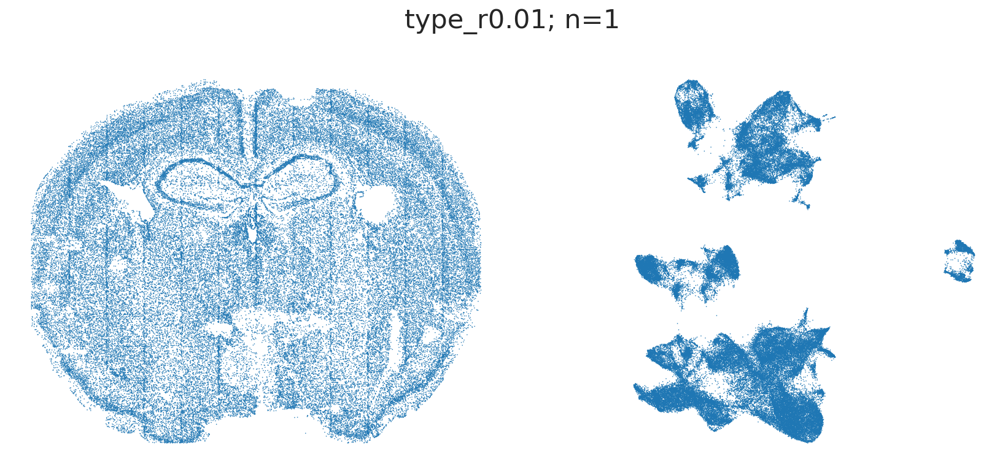

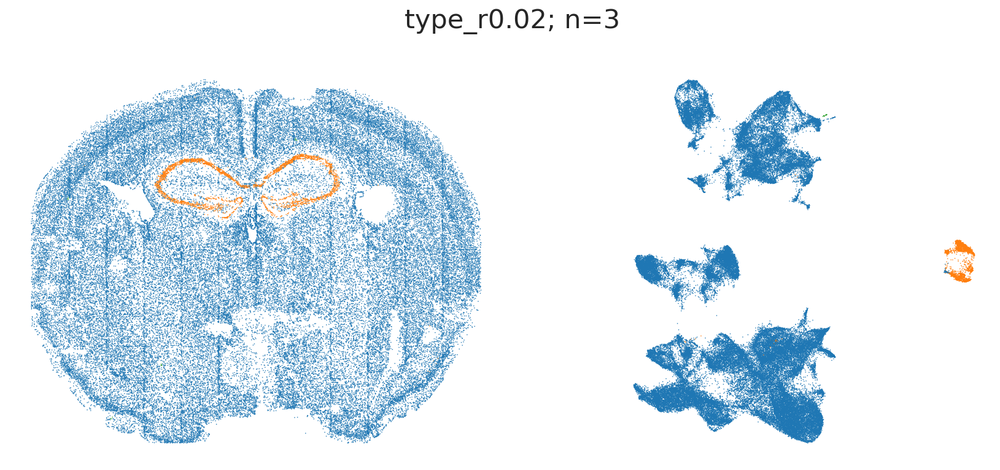

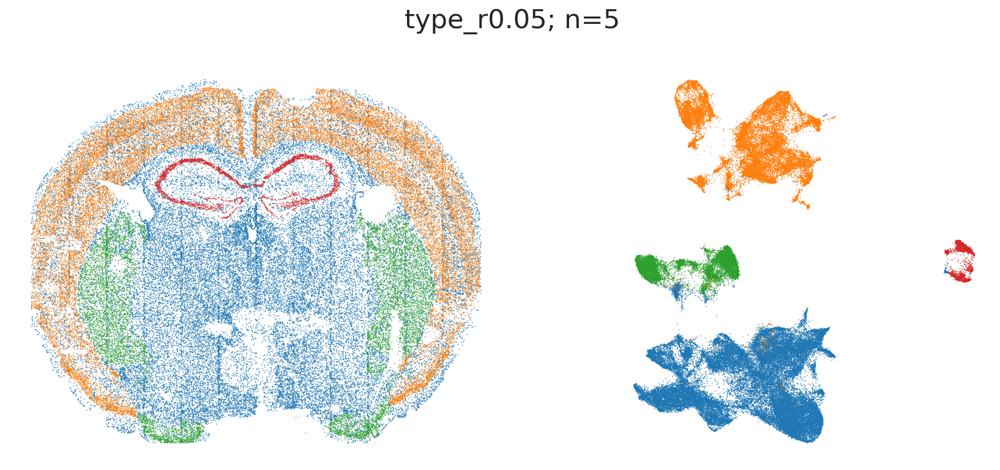

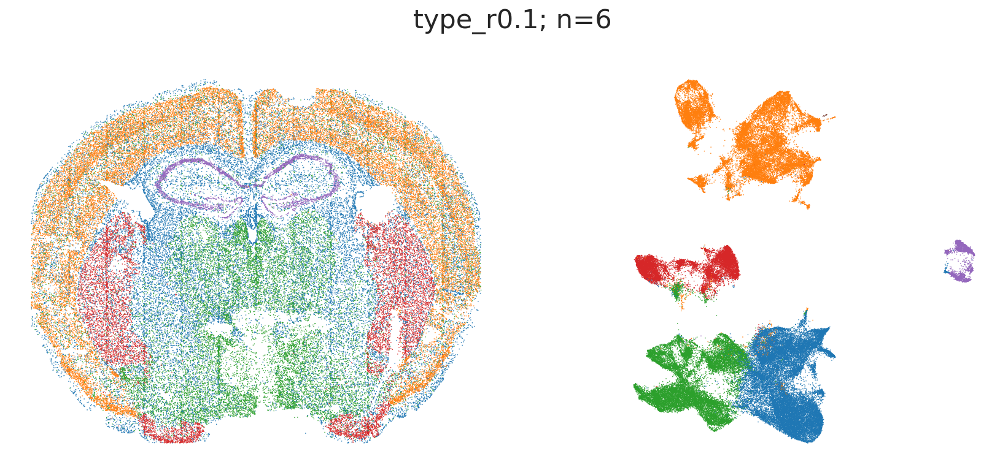

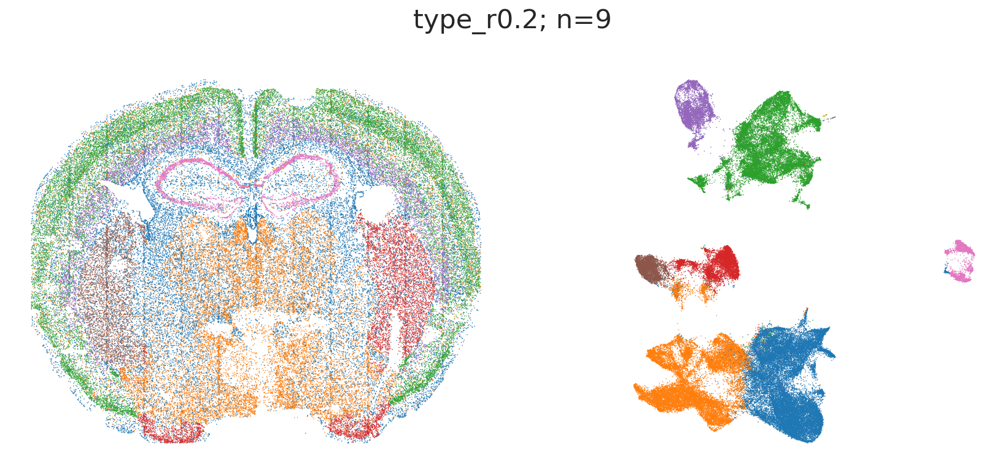

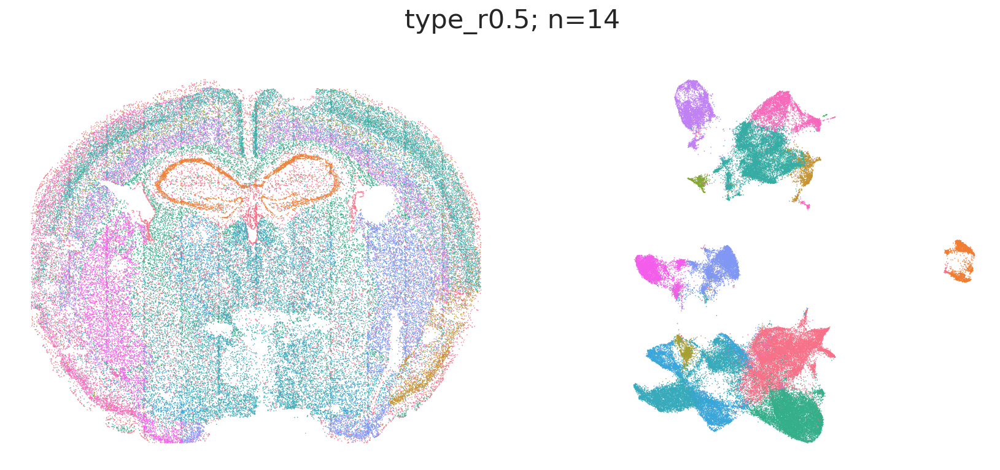

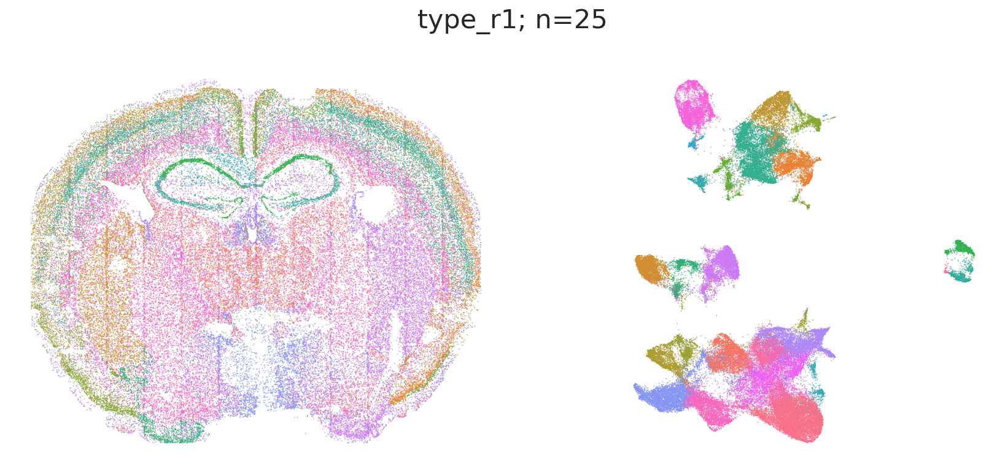

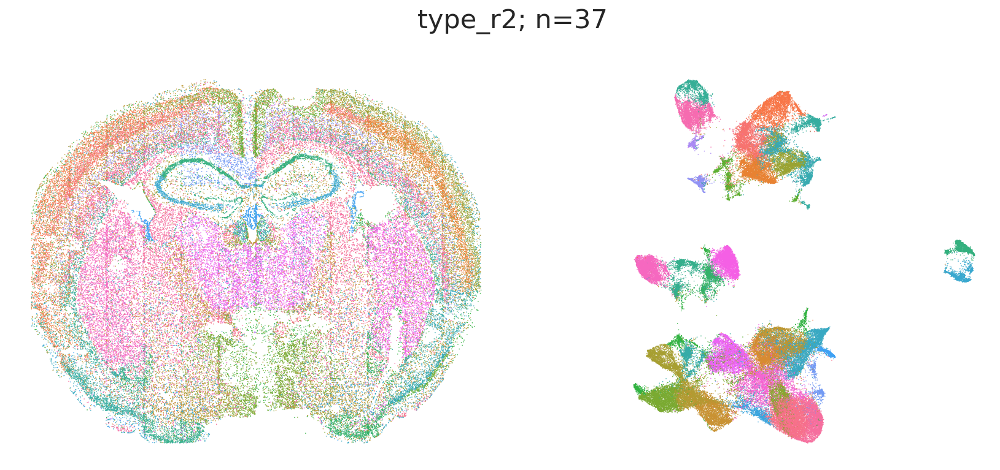

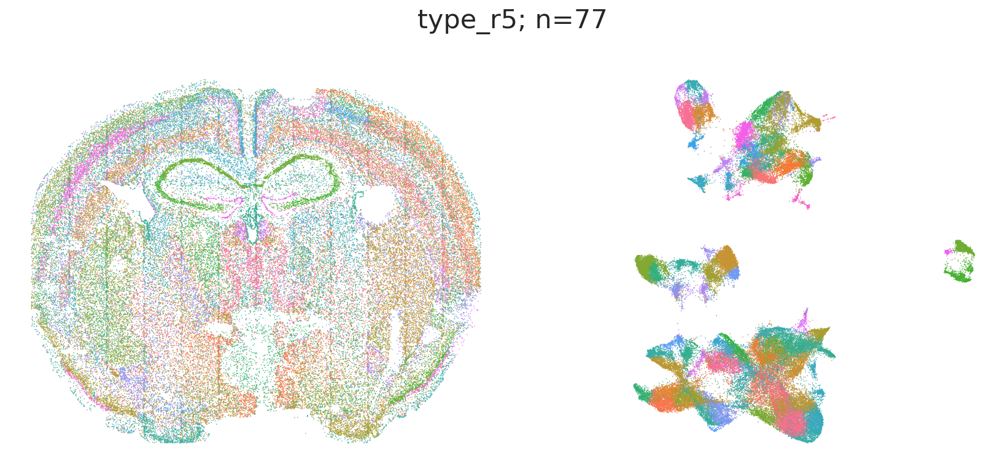

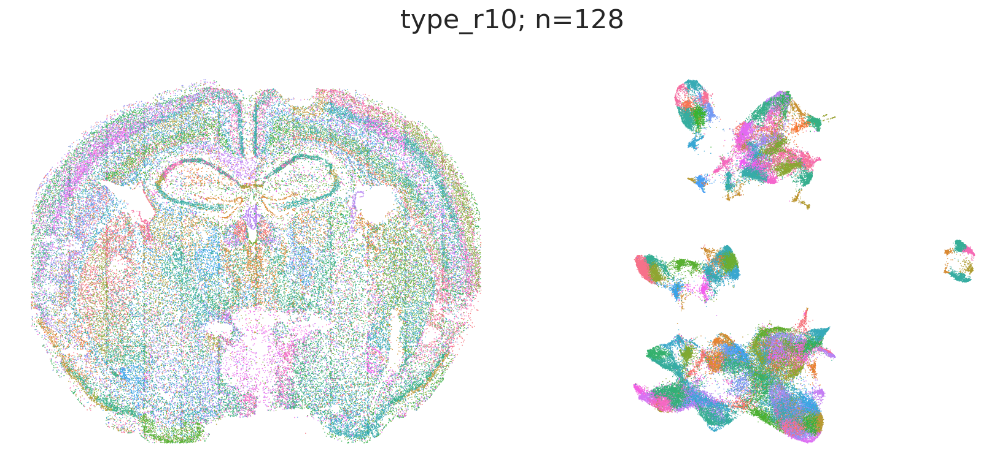

In [16]:
for r in resolutions:
    hue = f'type_r{r}'
    hue_order = np.sort(np.unique(df[hue]))
    ntypes = len(hue_order)

    fig, axs = plt.subplots(1, 2, figsize=(8*2,6))
    fig.suptitle(f"{hue}; n={ntypes}")
    ax = axs[0]
    sns.scatterplot(data=df, x='x', y='y', 
                    hue=hue, hue_order=hue_order, 
                    s=0.5, edgecolor=None, 
                    legend=False,
                    ax=ax)
    # ax.legend(loc='upper left', bbox_to_anchor=(0, -0.1), ncol=5)
    ax.set_aspect('equal')
    ax.axis('off')

    ax = axs[1]
    sns.scatterplot(data=df, x='umap_x', y='umap_y', 
                    hue=hue, hue_order=hue_order, 
                    s=0.5, edgecolor=None, 
                    legend=False,
                    ax=ax)
    # ax.legend(loc='upper left', bbox_to_anchor=(0, -0.1), ncol=5)
    ax.set_aspect('equal')
    ax.axis('off')
    fig.subplots_adjust(wspace=0)
    plt.show()

# Local env (Isozones)
- same cell type zones
- instead quantify the nearest neighbors of the same cell type

In [17]:
# call isozones
# compare the properties of isozone for each cell type
hue = 'type_r0.1'
labels = df[hue].values
labels

array(['t3', 't3', 't3', ..., 't2', 't1', 't4'], dtype=object)

In [18]:
# isozone
EL = np.asarray(layer.SG.get_edgelist())
EL_types = labels[EL]
EL_sametypes = EL[EL_types[:,0] == EL_types[:,1]]

IsoZoneG = igraph.Graph(n=N, edges=EL_sametypes, directed=False)
IsoZOneG = IsoZoneG.as_undirected().simplify() # what this means?
cmp = IsoZoneG.components()
Ix = np.asarray(cmp.membership)

isozones = Ix

In [19]:
labels, isozones

(array(['t3', 't3', 't3', ..., 't2', 't1', 't4'], dtype=object),
 array([   0,    1,    0, ..., 8419, 1695,   37]))

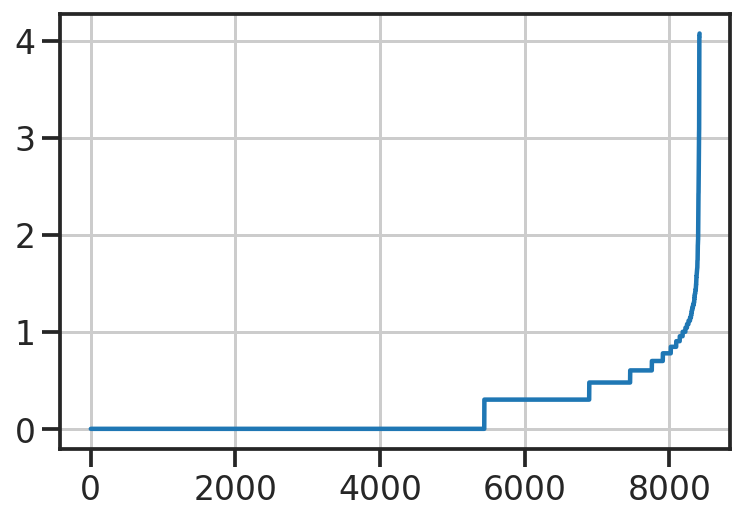

In [20]:
# Ix.shape
unq, cnts = np.unique(Ix, return_counts=True)
plt.plot(np.log10(np.sort(cnts)))

Text(0, 0.5, 'CDF - Num. Isozones or Cells')

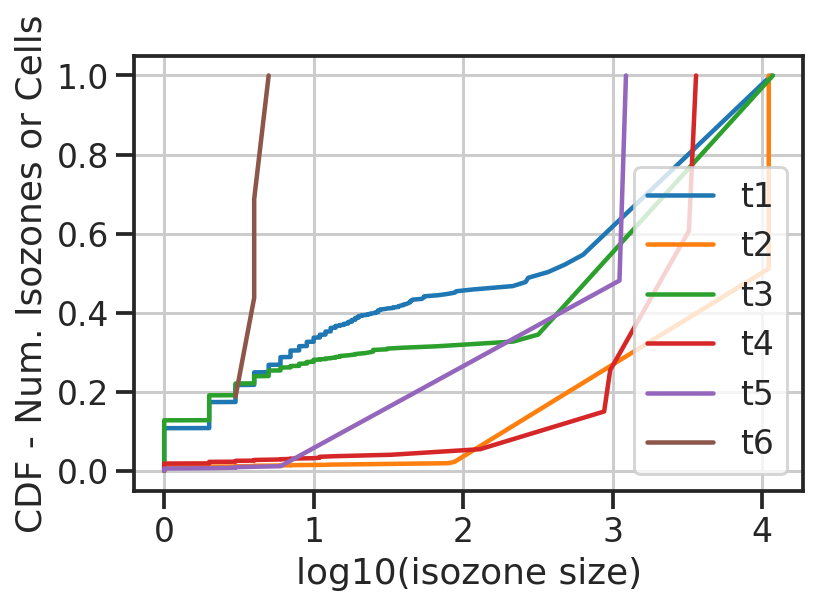

In [21]:

uniqlabels = np.sort(np.unique(labels))
for i in uniqlabels:
    subIso = isozones[labels==i]
    unq, cnts = np.unique(subIso, return_counts=True)
    # plt.plot(np.log10(np.sort(cnts)), np.linspace(0, 1, len(cnts)), label=i)
    _x = np.cumsum(np.sort(cnts))
    plt.plot(np.log10(np.sort(cnts)), _x/_x[-1], label=i)
    # plt.plot(np.sort(cnts), np.linspace(0, 1, len(cnts)), label=i)
plt.legend()
plt.xlabel('log10(isozone size)')
plt.ylabel('CDF - Num. Isozones or Cells')
    

# save df 

In [25]:
df.to_csv(os.path.join(basepth, "analysis_dev.csv"), header=True, index=True)

## Spatial nearest neighbors 

In [26]:
NearestNeighbors()

NearestNeighbors()

# Local env (Brain regions)